In [1]:
from src.params import PROCESSED, FIGURES_DIR, FEATURES
from src.clustering import compute_pca
from src.fig_utils import helper_save
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import glob
import time
import os
from os.path import join
from scipy.stats import zscore
import pickle
%matplotlib inline

Project Directory: /data2/isshamie/time_neutrophils

Config paths:
__name__ src.params
__package__ src
__file__ /data2/isshamie/time_neutrophils/src/params.py
__cached__ /data2/isshamie/time_neutrophils/src/__pycache__/params.cpython-37.pyc
path /data2/isshamie/time_neutrophils/src/params.py
DATA_DIR /data2/isshamie/time_neutrophils/data
RAW_DIR /data2/isshamie/time_neutrophils/data/raw
PROCESSED /data2/isshamie/time_neutrophils/data/processed
PARAM_DIR /data2/isshamie/time_neutrophils/parameters
RESULTS /data2/isshamie/time_neutrophils/results
FIGURES_DIR /data2/isshamie/time_neutrophils/figures


In [2]:
fig_dir = os.path.join(FIGURES_DIR,"pca_out")
if not os.path.exists(fig_dir):
    os.makedirs(fig_dir)

In [3]:
import matplotlib as mpl
mpl.style.use('fivethirtyeight')
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler


In [4]:
meta_df = pd.read_csv(join(PROCESSED, "meta.tsv"), sep="\t", index_col=0)

## PC on Z-scores

In [5]:
data_df = pickle.load(open(join(PROCESSED,"data_quantNorm_75.0.p"),"rb"))
data_df = data_df[FEATURES]
p = PCA(n_components=data_df.shape[1])
p.fit(data_df)
embedding = p.transform(data_df)


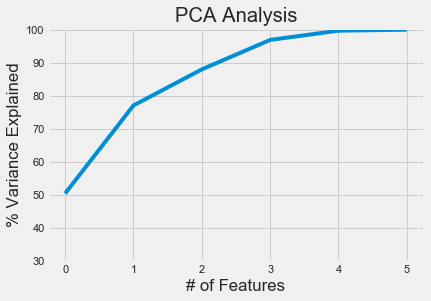

In [6]:
variance = p.explained_variance_ratio_ #calculate variance ratios

var=np.cumsum(np.round(p.explained_variance_ratio_, decimals=3)*100)
var #cumulative sum of variance explained with [n] features

plt.ylabel('% Variance Explained')
plt.xlabel('# of Features')
plt.title('PCA Analysis')
plt.ylim(30,100.5)

plt.plot(var)



In [7]:
def biplot(score,coeff,labels=None, PCs=(1,2)):
    f = plt.figure()
    xs = score[:,0]
    ys = score[:,1]
    n = coeff.shape[0]
    scalex = 1.0/(xs.max() - xs.min())
    scaley = 1.0/(ys.max() - ys.min())
    plt.scatter(xs * scalex,ys * scaley)
    for i in range(n):
        plt.arrow(0, 0, coeff[i,0], coeff[i,1],color = 'r',alpha = 0.5)
        if labels is None:
            plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, "Var"+str(i+1), color = 'g', ha = 'center', va = 'center')
        else:
            plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, labels[i], color = 'g', ha = 'center', va = 'center')
    plt.xlim(-1,1)
    plt.ylim(-1,1)
    plt.xlabel("PC{}".format(PCs[0]))
    plt.ylabel("PC{}".format(PCs[1]))
    plt.grid()


In [8]:
p = PCA(n_components=3)
p.fit(data_df[["PI Intensity", "AnexinV Intensity", "Cell Tracker Intensity"]])
embedding = p.transform(data_df[["PI Intensity", "AnexinV Intensity", "Cell Tracker Intensity"]])


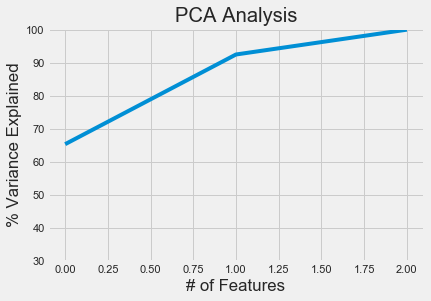

In [9]:
variance = p.explained_variance_ratio_ #calculate variance ratios

var=np.cumsum(np.round(p.explained_variance_ratio_, decimals=3)*100)
var #cumulative sum of variance explained with [n] features

plt.ylabel('% Variance Explained')
plt.xlabel('# of Features')
plt.title('PCA Analysis')
plt.ylim(30,100.5)


plt.plot(var)

In [10]:
df = meta_df.copy()
df["embedding_1"] = embedding[:,0]
df["embedding_2"] = embedding[:,1]

df = pd.merge(df, data_df, how='inner',left_index=True, right_index=True)
df

,Timepoint,Stimuli,Sample,Genotype,Stimuli Names,embedding_1,embedding_2,Cell Size,Cell Circularity,Cell Aspect Ratio,Cell Tracker Intensity,PI Intensity,AnexinV Intensity
0_2G3,3,G,2,WT,Nec1s,-0.263655,0.049795,35.285285,0.011411,1.258566,1.032698,0.467184,0.853761
1_2G3,3,G,2,WT,Nec1s,-0.273132,-0.041901,0.183183,0.051684,27.056397,0.869179,0.460161,0.684543
2_2G3,3,G,2,WT,Nec1s,-0.272438,-0.037212,0.036036,0.258518,5.322570,0.894355,0.463055,0.700590
3_2G3,3,G,2,WT,Nec1s,-0.276104,-0.052649,0.069069,0.136180,10.201592,0.930827,0.468737,0.699239
4_2G3,3,G,2,WT,Nec1s,-0.277575,-0.045270,0.006006,1.007535,0.887095,0.925925,0.464625,0.704211
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4592_4B46,46,B,4,WT,zVD,-0.275342,0.376627,1.430464,0.944452,0.865979,0.437843,0.284648,0.928284
4593_4B46,46,B,4,WT,zVD,-0.126533,0.421552,2.450331,0.492189,2.494880,0.382821,0.409539,1.002850
4594_4B46,46,B,4,WT,zVD,0.351156,0.145368,1.039735,0.866388,1.224443,0.431961,0.955802,0.906272
4595_4B46,46,B,4,WT,zVD,2.169267,-0.565079,0.125828,1.003322,1.051445,0.633954,2.944559,0.897136


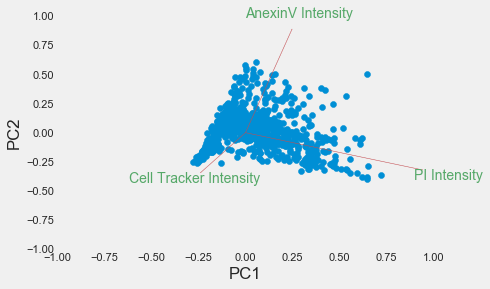

In [11]:
biplot(df[["embedding_1", "embedding_2"]].sample(1000, replace=False).values,
       np.transpose(p.components_[0:2, :]), 
       labels=["PI Intensity", "AnexinV Intensity", "Cell Tracker Intensity"])
plt.show()

## Plot the sample label (6stimuli*5wt + 6stimuli*6KO = 66)

In [12]:
df["Experiment"] = ""
for ind,val in df.groupby(["Stimuli", "Sample", "Genotype"]):
    print(ind)
    df.loc[val.index, "Experiment"] = '_'.join(map(lambda x: str(x), ind))

('A', 1, 'WT')
('A', 2, 'WT')
('A', 3, 'WT')
('A', 4, 'WT')
('A', 5, 'WT')
('A', 6, 'Pad4KO')
('A', 7, 'Pad4KO')
('A', 8, 'Pad4KO')
('A', 9, 'Pad4KO')
('A', 10, 'Pad4KO')
('A', 11, 'Pad4KO')
('A', 12, 'Pad4KO')
('B', 1, 'WT')
('B', 2, 'WT')
('B', 3, 'WT')
('B', 4, 'WT')
('B', 5, 'WT')
('B', 6, 'Pad4KO')
('B', 7, 'Pad4KO')
('B', 8, 'Pad4KO')
('B', 9, 'Pad4KO')
('B', 10, 'Pad4KO')
('B', 11, 'Pad4KO')
('B', 12, 'Pad4KO')
('C', 1, 'WT')
('C', 2, 'WT')
('C', 3, 'WT')
('C', 4, 'WT')
('C', 5, 'WT')
('C', 6, 'Pad4KO')
('C', 7, 'Pad4KO')
('C', 8, 'Pad4KO')
('C', 9, 'Pad4KO')
('C', 10, 'Pad4KO')
('C', 11, 'Pad4KO')
('C', 12, 'Pad4KO')
('D', 1, 'WT')
('D', 2, 'WT')
('D', 3, 'WT')
('D', 4, 'WT')
('D', 5, 'WT')
('D', 6, 'Pad4KO')
('D', 7, 'Pad4KO')
('D', 8, 'Pad4KO')
('D', 9, 'Pad4KO')
('D', 10, 'Pad4KO')
('D', 11, 'Pad4KO')
('D', 12, 'Pad4KO')
('E', 1, 'WT')
('E', 2, 'WT')
('E', 3, 'WT')
('E', 4, 'WT')
('E', 5, 'WT')
('E', 6, 'Pad4KO')
('E', 7, 'Pad4KO')
('E', 8, 'Pad4KO')
('E', 9, 'Pad4KO')
('E',

/home/isshamie/software/anaconda2/envs/umap/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


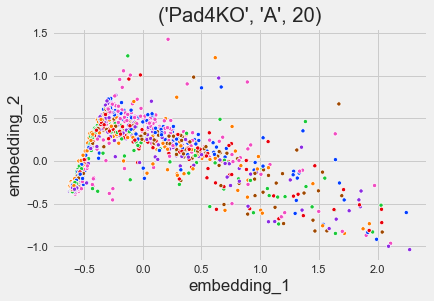

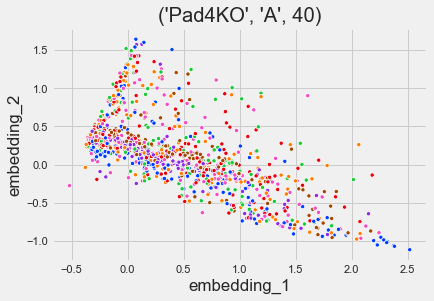

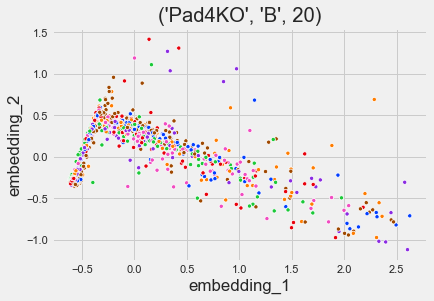

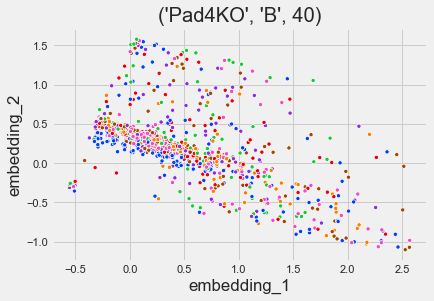

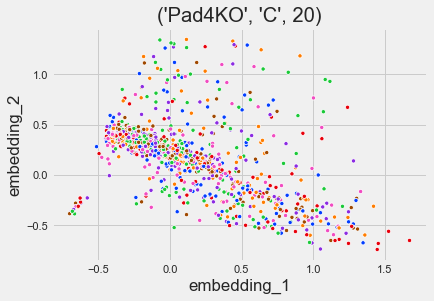

...

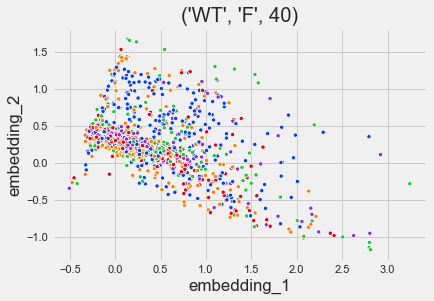

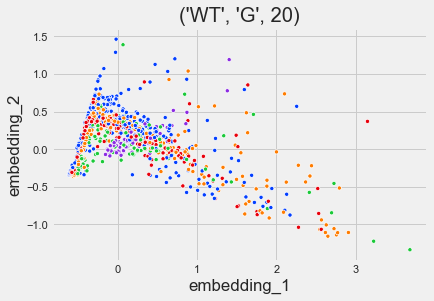

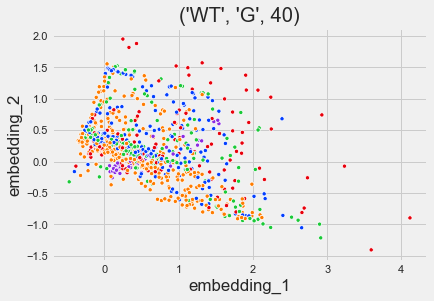

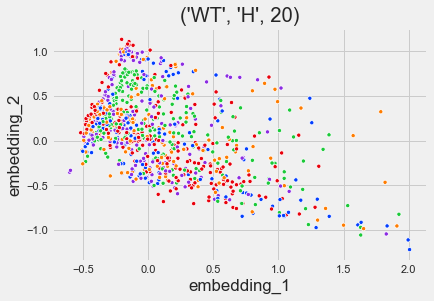

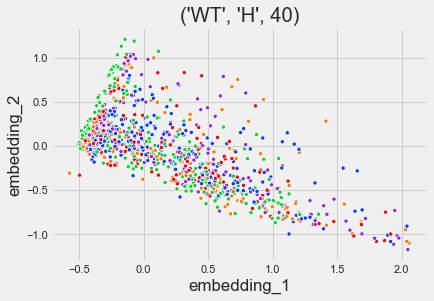

In [13]:
for ind, val in df.groupby(["Genotype", "Stimuli", "Timepoint"]):
    if ind[-1] % 20 == 0: #Every 5 timepoints
        curr_df = val.sample(n = 1000, replace=False)
        color_labels = curr_df["Experiment"].unique()
        pallete=sns.color_palette("bright", len(color_labels))
        plt.figure()
        sns.scatterplot(data=curr_df,x="embedding_1", y="embedding_2", palette=pallete, hue='Experiment',style="Genotype",
                                size=0.5)
        plt.gca().legend().set_visible(False)

        plt.title(ind)




### Biplot

-----

## PCA on log10 then whiten

In [29]:
data_df = pickle.load(open(join(PROCESSED,"data_df_log10.p"),"rb"))

p = PCA(n_components=data_df.shape[1])
p.fit(StandardScaler().fit_transform(data_df.values))
embedding = p.transform(data_df)

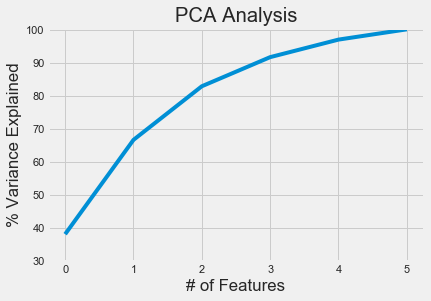

In [30]:
variance = p.explained_variance_ratio_ #calculate variance ratios

var=np.cumsum(np.round(p.explained_variance_ratio_, decimals=3)*100)
var #cumulative sum of variance explained with [n] features

plt.ylabel('% Variance Explained')
plt.xlabel('# of Features')
plt.title('PCA Analysis')
plt.ylim(30,100.5)


plt.plot(var)

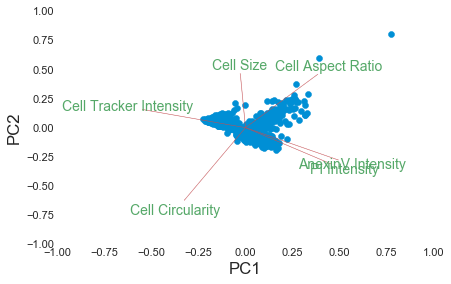

In [32]:
biplot(df[["embedding_1", "embedding_2"]].sample(1000, replace=False).values,
       np.transpose(p.components_[0:2, :]), 
       labels=data_df.columns.values)
plt.show()


In [17]:
df = meta_df.copy()
df["embedding_1"] = embedding[:,0]
df["embedding_2"] = embedding[:,1]
df = pd.merge(df, data_df, how='inner',left_index=True, right_index=True)
df

,Timepoint,Stimuli,Sample,Genotype,Stimuli Names,embedding_1,embedding_2,Cell Size,Cell Circularity,Cell Aspect Ratio,Cell Tracker Intensity,PI Intensity,AnexinV Intensity
0_2G3,3,G,2,WT,Nec1s,0.598067,-0.714218,4.070038,2.054053,0.452936,4.326174,3.470068,4.024921
1_2G3,3,G,2,WT,Nec1s,0.948859,-1.548945,1.785330,2.710094,1.785330,4.251310,3.463489,3.928986
2_2G3,3,G,2,WT,Nec1s,0.470879,-2.630240,1.079181,3.409231,1.079181,4.263711,3.466212,3.939049
3_2G3,3,G,2,WT,Nec1s,0.653995,-2.197846,1.361728,3.130852,1.361728,4.281070,3.471509,3.938211
4_2G3,3,G,2,WT,Nec1s,-0.003412,-3.707357,0.301030,4.000000,0.301030,4.278776,3.467682,3.941288
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4592_4B46,46,B,4,WT,zVD,0.237352,-3.096194,2.334454,3.973740,0.020651,4.155768,3.651395,4.438900
4593_4B46,46,B,4,WT,zVD,0.618993,-2.671599,2.568202,3.690692,0.480194,4.097446,3.809382,4.472455
4594_4B46,46,B,4,WT,zVD,0.549272,-3.230295,2.195900,3.936272,0.171083,4.149894,4.177454,4.428477
4595_4B46,46,B,4,WT,zVD,0.658720,-3.847361,1.278754,4.000000,0.104931,4.316508,4.666106,4.424077


/home/isshamie/software/anaconda2/envs/umap/lib/python3.7/site-packages/ipykernel_launcher.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/home/isshamie/software/anaconda2/envs/umap/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # Remove the CWD from sys.path while we load stuff.


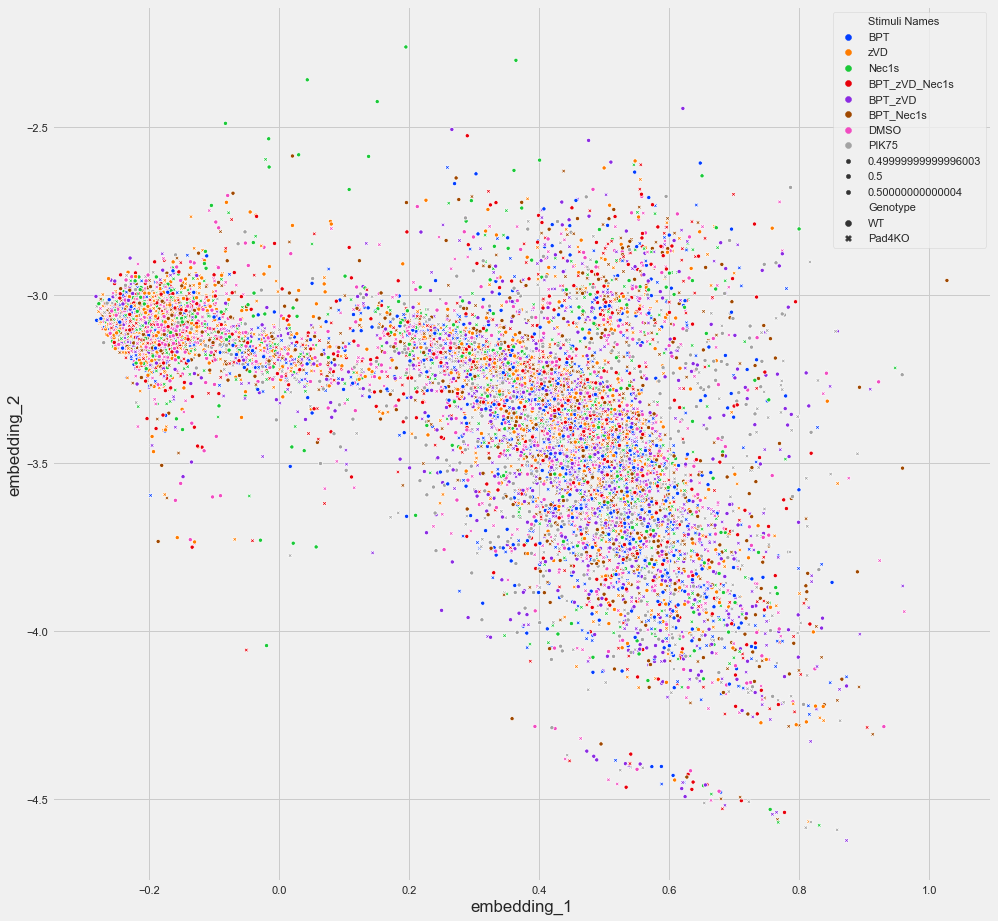

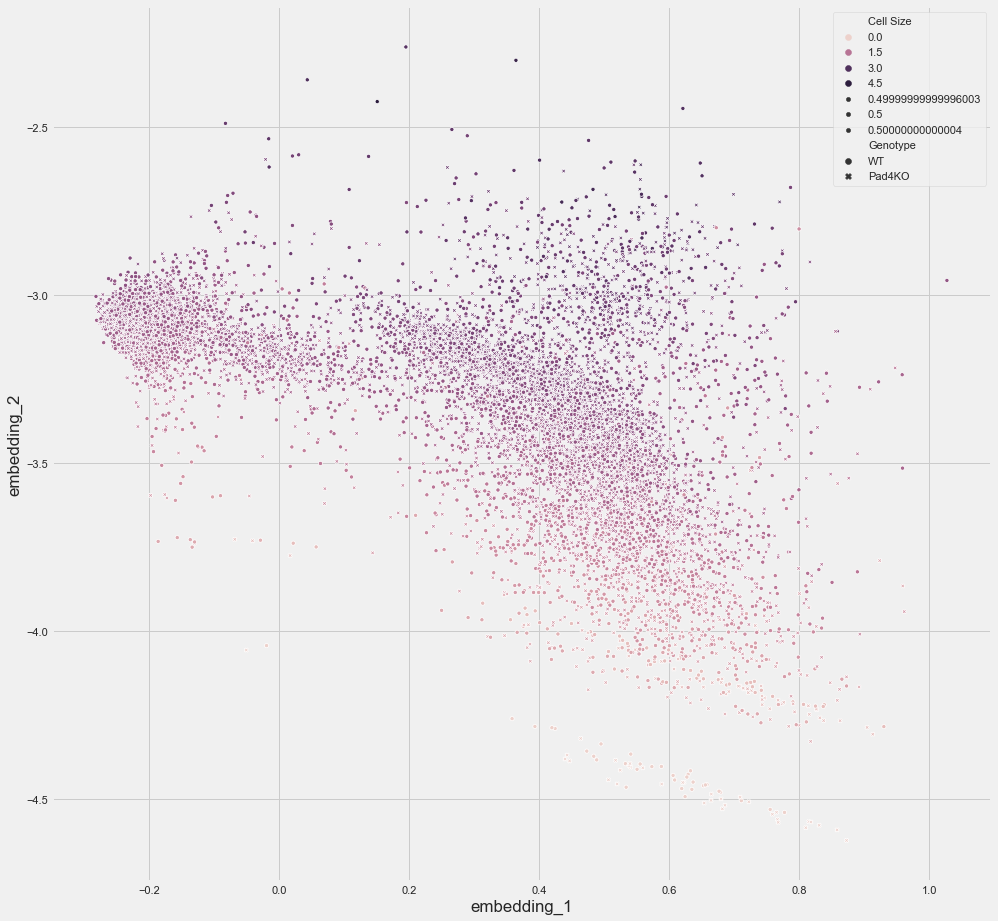

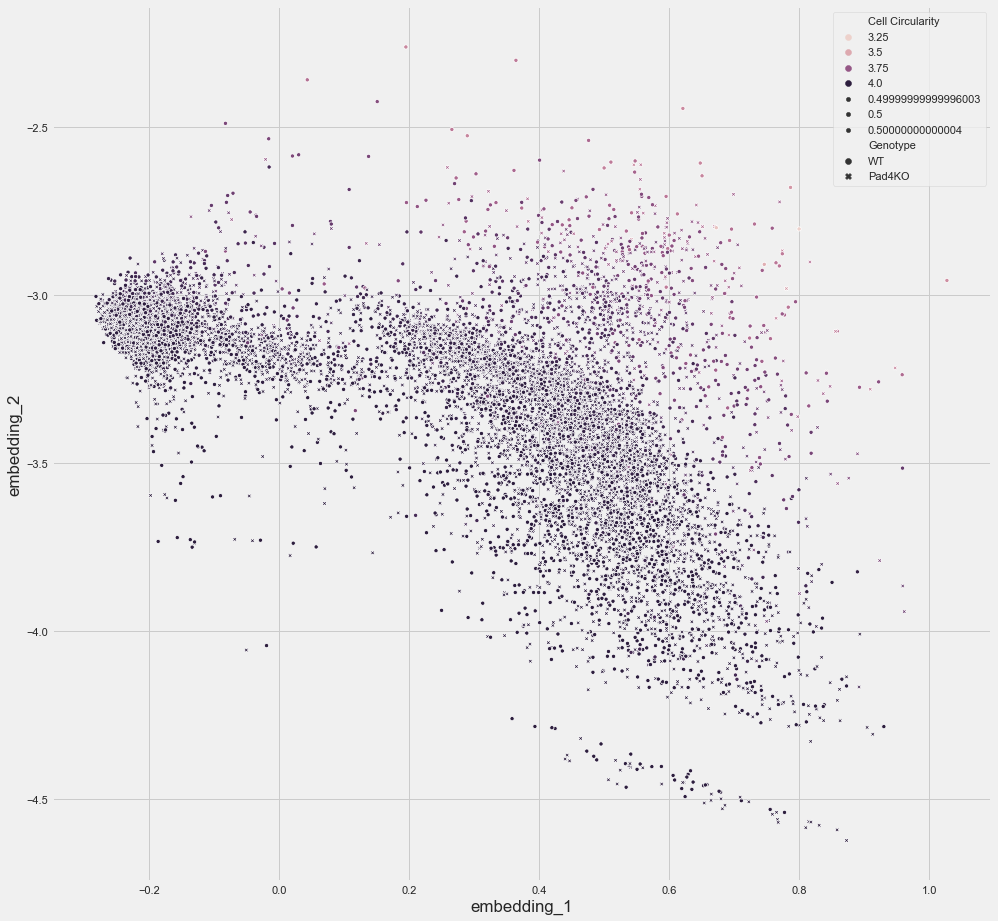

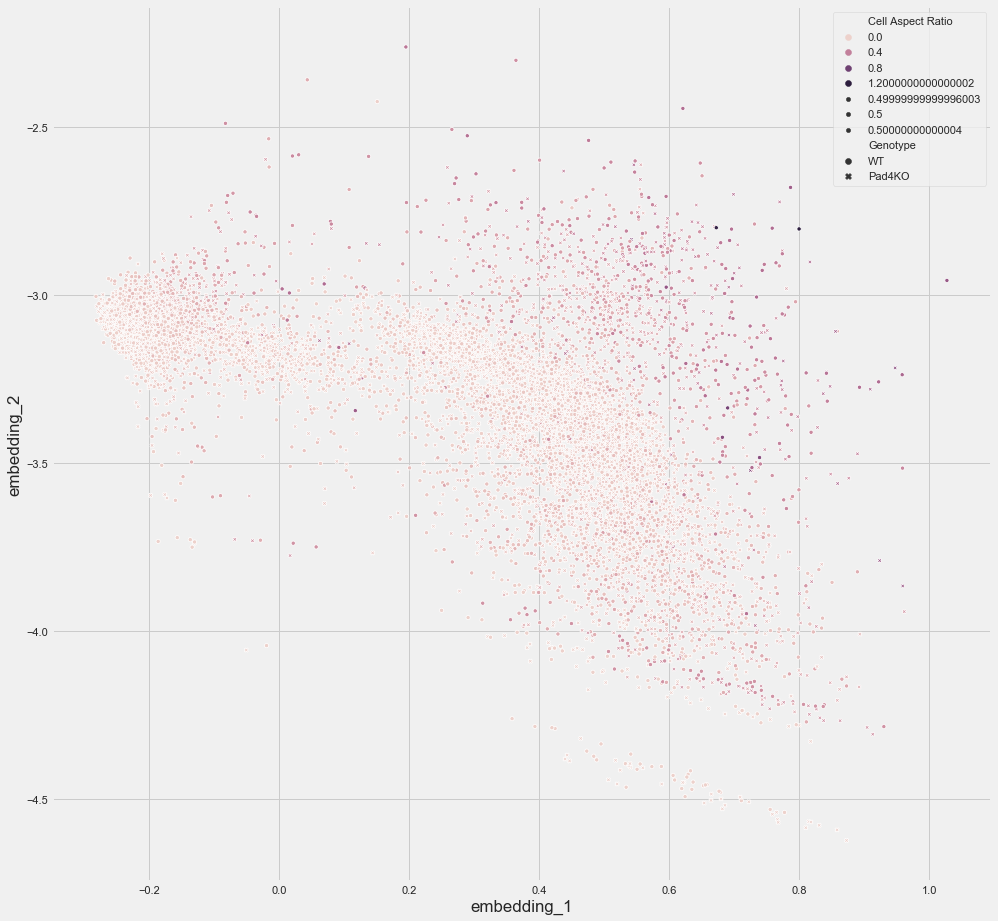

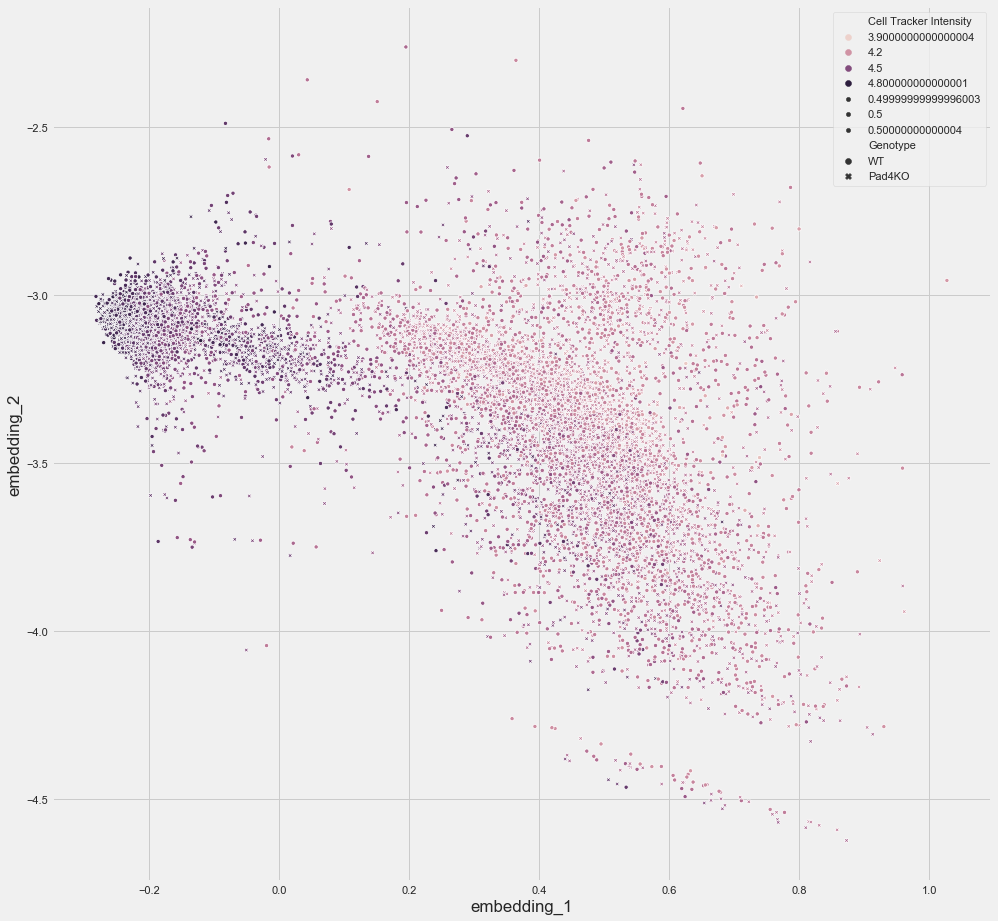

...

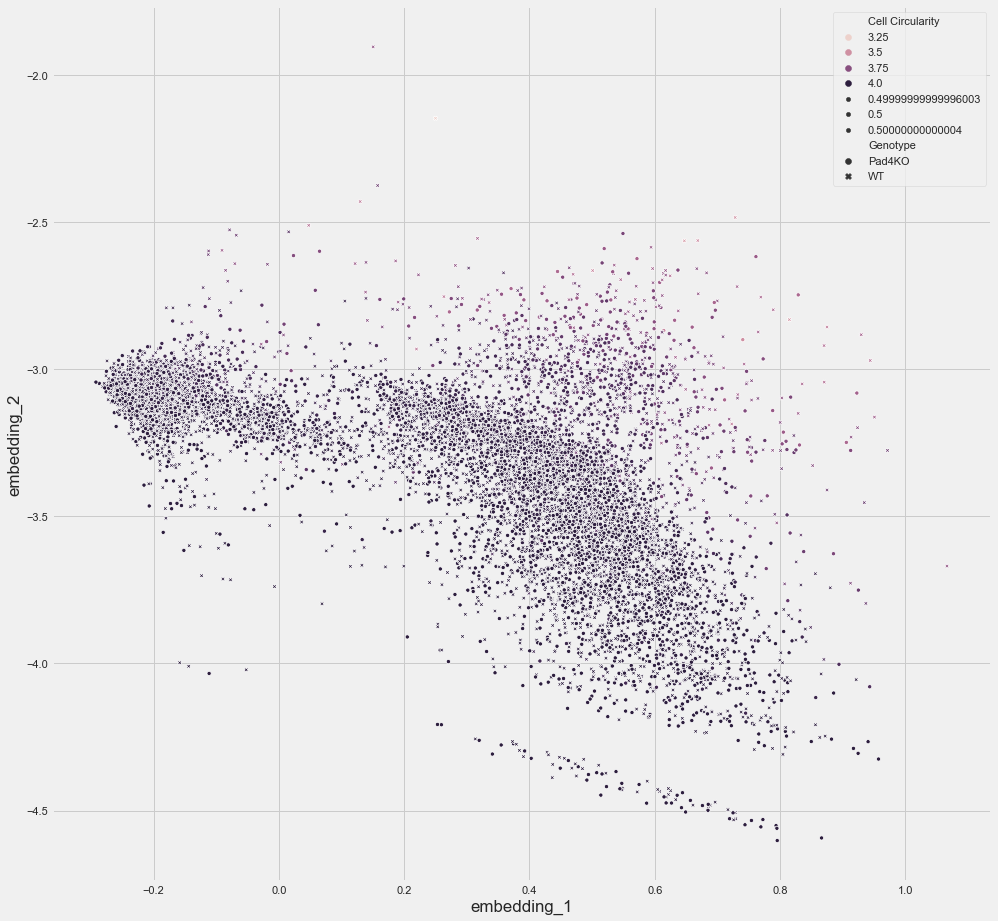

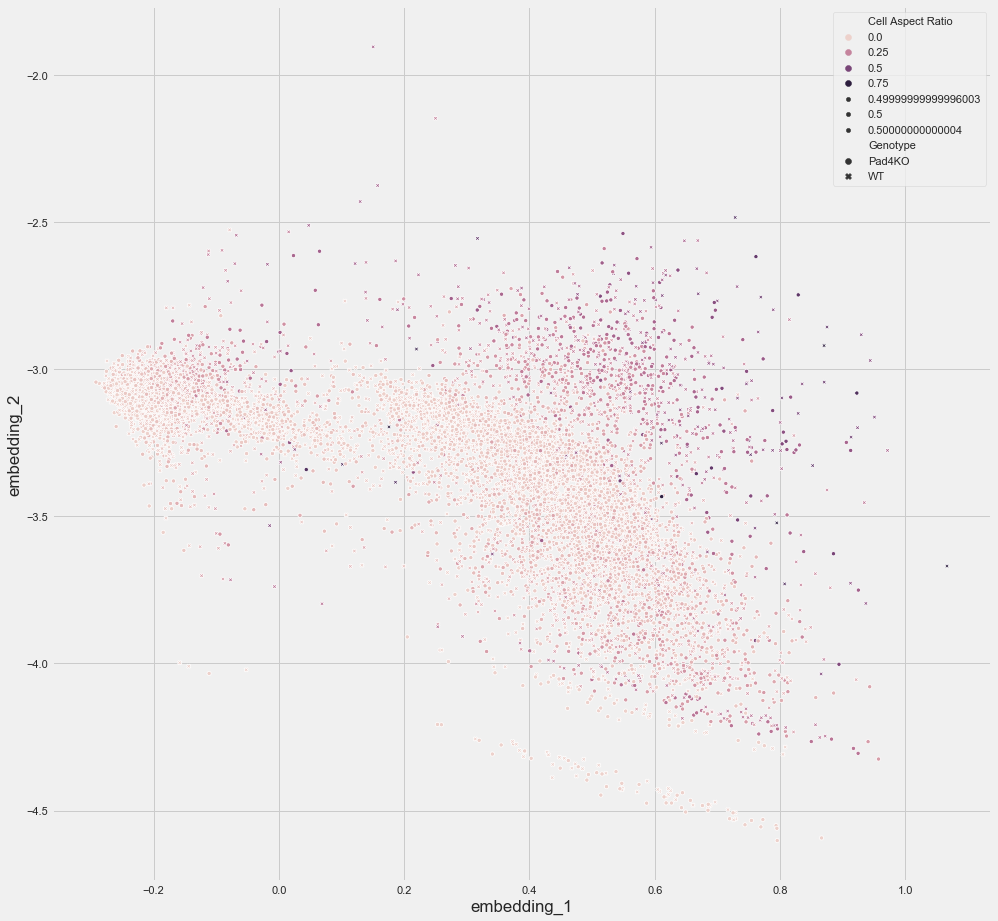

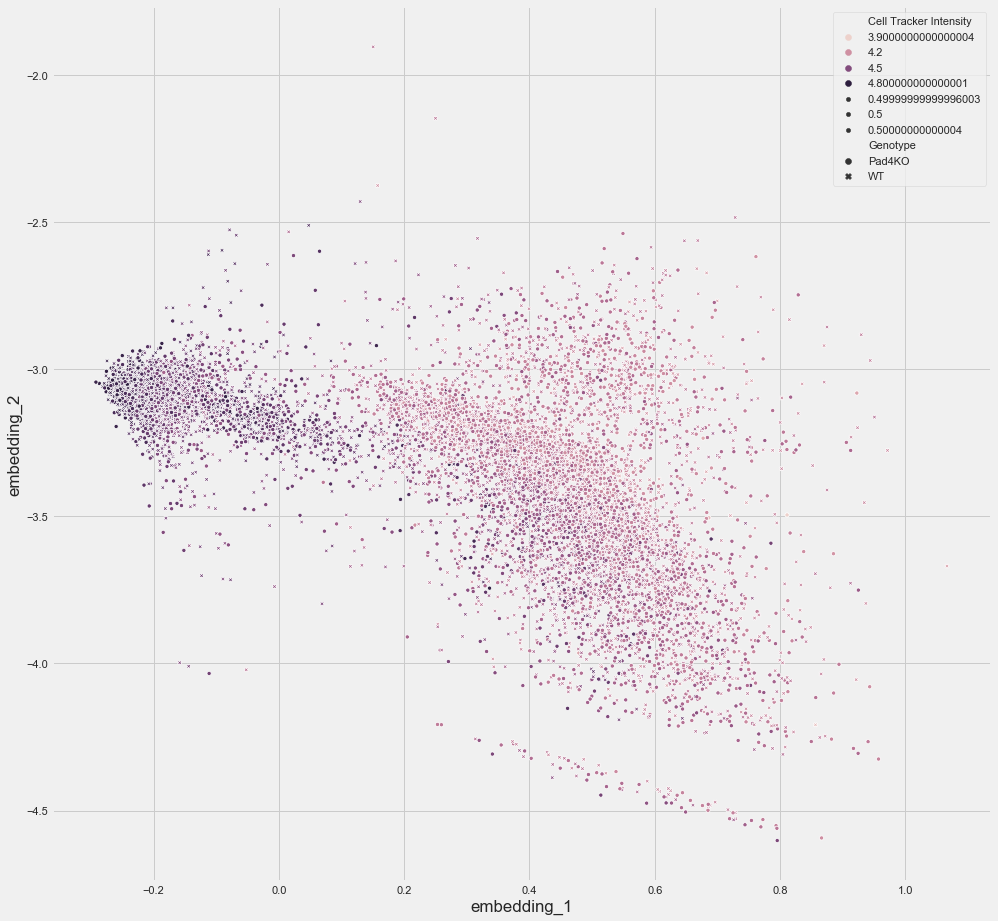

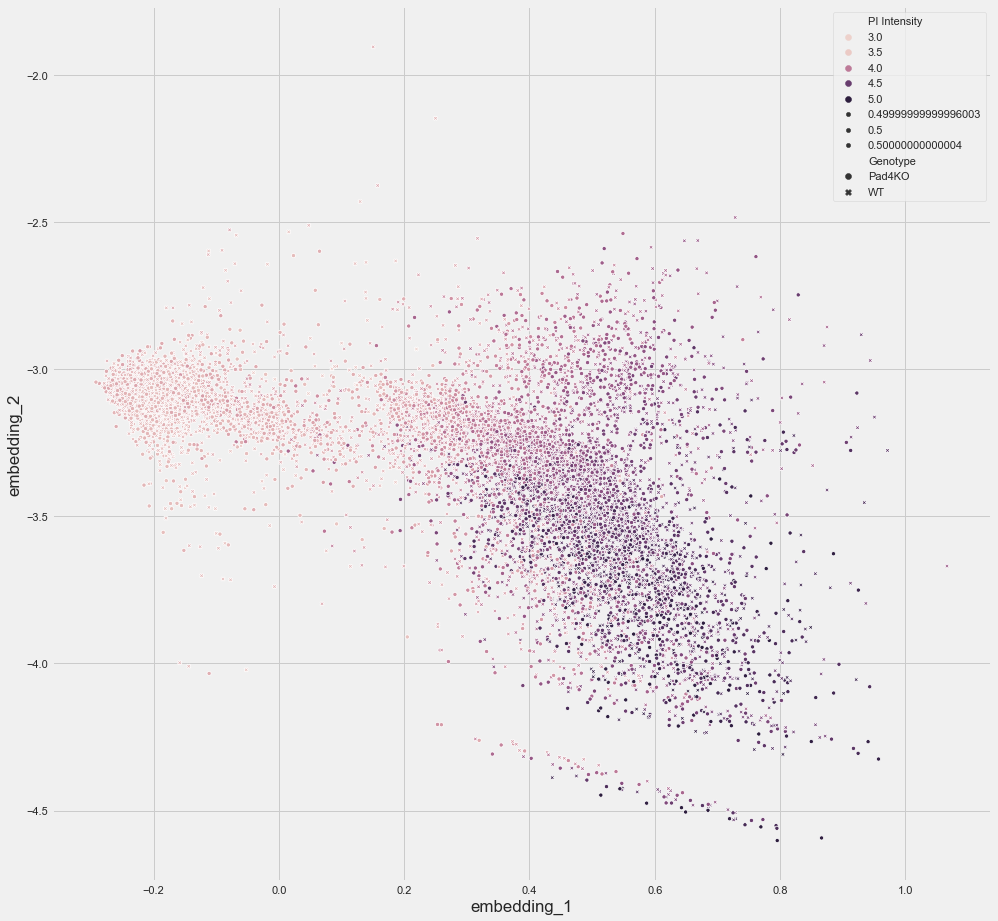

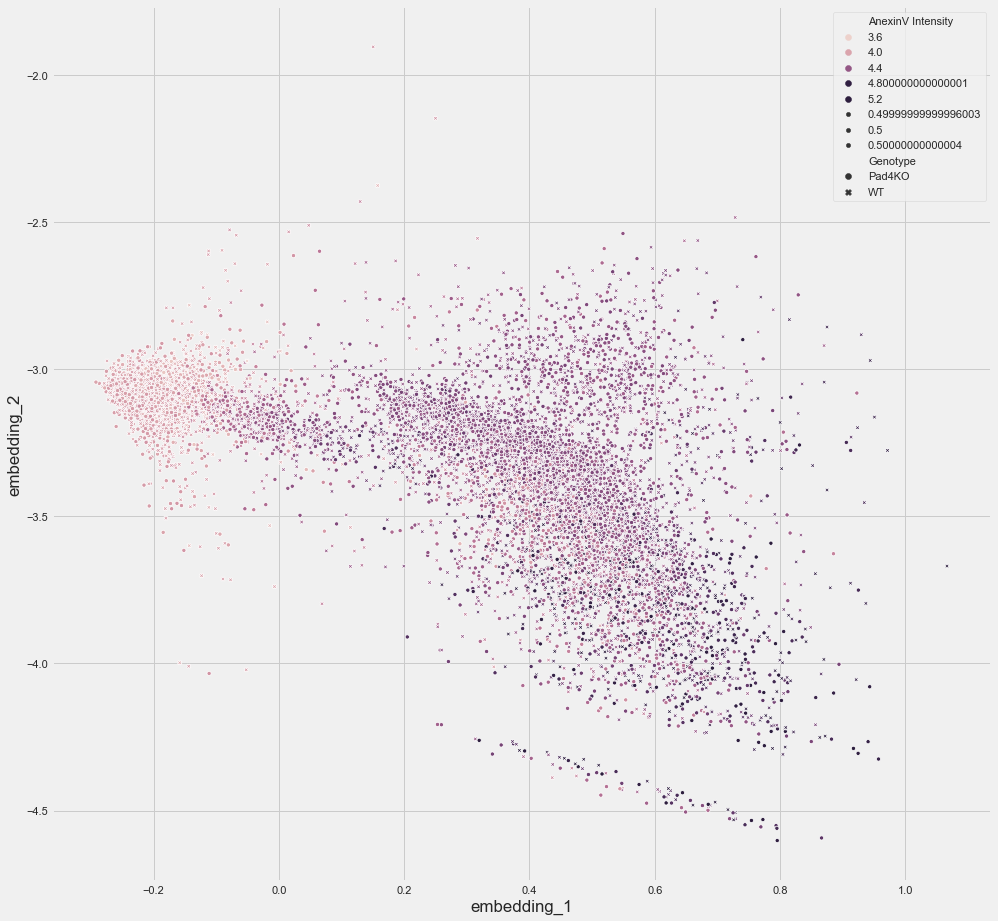

In [18]:
n_iter = 5
n_sample = 1000
# Create figures
color_labels = df["Stimuli Names"].unique()
rgb_values = (sns.color_palette("Set2", len(color_labels)))
color_map = dict(zip(color_labels, rgb_values))

for i in range(n_iter):
    curr_df = df.sample(n = 10000, replace=False)
    plt.figure(figsize=(15,15))
    pallete=sns.color_palette("bright", len(color_labels))
    sns.scatterplot(data=curr_df,x="embedding_1", y="embedding_2", palette=pallete, hue='Stimuli Names',style="Genotype",
                            size=0.5)

    plt.legend(loc='upper right')



    for i in data_df.columns.values:
        plt.figure(figsize=(15,15))
        pallete=sns.color_palette("bright", len(color_labels))
        sns.scatterplot(data=curr_df,x="embedding_1", y="embedding_2", hue=i,
                        style="Genotype", size=0.5)
        #df.plot.scatter("embedding_1","embedding_2", hue=df['Stimuli'])#.map(color_map),s=0.5)
        plt.legend(loc='upper right')


----------------

----------------

----------------

## Plot the sample label (6stimuli*5wt + 6stimuli*6KO = 66)

In [19]:
df["Experiment"] = ""
for ind,val in df.groupby(["Stimuli", "Sample", "Genotype"]):
    print(ind)
    df.loc[val.index, "Experiment"] = '_'.join(map(lambda x: str(x), ind))

('A', 1, 'WT')
('A', 2, 'WT')
('A', 3, 'WT')
('A', 4, 'WT')
('A', 5, 'WT')
('A', 6, 'Pad4KO')
('A', 7, 'Pad4KO')
('A', 8, 'Pad4KO')
('A', 9, 'Pad4KO')
('A', 10, 'Pad4KO')
('A', 11, 'Pad4KO')
('A', 12, 'Pad4KO')
('B', 1, 'WT')
('B', 2, 'WT')
('B', 3, 'WT')
('B', 4, 'WT')
('B', 5, 'WT')
('B', 6, 'Pad4KO')
('B', 7, 'Pad4KO')
('B', 8, 'Pad4KO')
('B', 9, 'Pad4KO')
('B', 10, 'Pad4KO')
('B', 11, 'Pad4KO')
('B', 12, 'Pad4KO')
('C', 1, 'WT')
('C', 2, 'WT')
('C', 3, 'WT')
('C', 4, 'WT')
('C', 5, 'WT')
('C', 6, 'Pad4KO')
('C', 7, 'Pad4KO')
('C', 8, 'Pad4KO')
('C', 9, 'Pad4KO')
('C', 10, 'Pad4KO')
('C', 11, 'Pad4KO')
('C', 12, 'Pad4KO')
('D', 1, 'WT')
('D', 2, 'WT')
('D', 3, 'WT')
('D', 4, 'WT')
('D', 5, 'WT')
('D', 6, 'Pad4KO')
('D', 7, 'Pad4KO')
('D', 8, 'Pad4KO')
('D', 9, 'Pad4KO')
('D', 10, 'Pad4KO')
('D', 11, 'Pad4KO')
('D', 12, 'Pad4KO')
('E', 1, 'WT')
('E', 2, 'WT')
('E', 3, 'WT')
('E', 4, 'WT')
('E', 5, 'WT')
('E', 6, 'Pad4KO')
('E', 7, 'Pad4KO')
('E', 8, 'Pad4KO')
('E', 9, 'Pad4KO')
('E',

In [20]:
for ind, val in df.groupby(["Genotype", "Stimuli", "Timepoint"]):
    if ind[-1] % 20 == 0: #Every 5 timepoints
        curr_df = val.sample(n = 1000, replace=False)
        color_labels = curr_df["Experiment"].unique()
        pallete=sns.color_palette("bright", len(color_labels))
        plt.figure()
        sns.scatterplot(data=curr_df,x="embedding_1", y="embedding_2", palette=pallete, hue='Experiment',style="Genotype",
                                size=0.5)
        plt.gca().legend().set_visible(False)

        plt.title(ind)




KeyboardInterrupt: 